In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

#from PIL import Image 
#import rasterio as rio
#import random

#import os
#import cv2

# Reload utils
import importlib

from train_landsat_unet import * #load dataset and model classes

import utils
importlib.reload(utils)

base_path = '../data/'

In [23]:
#Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import cv2
from PIL import Image
from osgeo import gdal

import os
import glob
import random
import torch

class model_eval:

    def __init__(self, model, images,targets, preds):
        self.model = model
        self.images = images
        self.targets = targets
        self.preds = preds
        self.fig_path = '/Users/conorosullivan/Google Drive/My Drive/UCD/research/Interpreting UNet/Figures/{}.png'
        self.device = torch.device('mps') 

    def calc_accuracy(self,pred, target):
        """Returns accuracy of model prediction"""
        
        correct = np.sum(target == pred)
        h,w = target.shape

        accuracy = correct/(h*w)
            
        return correct, accuracy
    
    def get_rgb(self,i):
        """Return normalized RGB channels from sentinal image"""
        img = self.images[i].cpu().detach().numpy()

        rgb = img[[3,2,1]]
        rgb = rgb.transpose(1,2,0) 
        rgb = np.clip(rgb, 0, 0.3)/0.3

        return rgb

    def plot_pred(self,i,save=None):
        """Diplays RGB image, label and prediction with accuracy"""
        rgb = self.get_rgb(i)
        target = self.targets[i]
        pred = self.preds[i]

        fig,axs = plt.subplots(1,3,figsize=(15,15))
        fig.patch.set_facecolor('xkcd:white')

        axs[0].imshow(rgb)
        axs[0].set_title("RGB Image",size=15)

        axs[1].imshow(target,cmap="gray")
        axs[1].set_title("Target",size=15)

        axs[2].imshow(pred,cmap="gray")
        correct, accuracy = self.calc_accuracy(pred, target)
        accuracy = round(accuracy*100, 2)
        axs[2].set_title("Accuracy: {}%".format(accuracy))

        for ax in axs:
            ax.set_xticks([])
            ax.set_yticks([])

        if save:
            plt.savefig(self.fig_path.format(save),bbox_inches='tight',dpi=300)

    
    def confusion_metrics(self,pred,target):
        """Returns confusion matrix metrics"""
        
        TP = np.sum((pred == 1) & (target == 1))
        TN = np.sum((pred == 0) & (target == 0))
        FP = np.sum((pred == 1) & (target == 0))
        FN = np.sum((pred == 0) & (target == 1))
        
        return TP,TN,FP,FN
    
    def eval_metrics(self):
        """Evaluate model performance on test set"""

        TP,TN,FP,FN =0,0,0,0
        r_accuracy = []
        r_balanced_accuracy = []
        r_precision = []
        r_recall = []
        r_f1 = []

        # Calcualte accuracy
        for i in range(len(self.targets)):
            target = self.targets[i]
            pred = self.preds[i]

            TP_,TN_,FP_,FN_ = self.confusion_metrics(pred,target)
            TP += TP_
            TN += TN_
            FP += FP_
            FN += FN_

            r_accuracy.append((TP_+TN_)/(TP_+TN_+FP_+FN_))
            r_balanced_accuracy.append(0.5*(TP_/(TP_+FN_) + TN_/(TN_+FP_)))
            r_precision.append(TP_/(TP_+FP_))
            r_recall.append(TP_/(TP_+FN_))
            r_f1.append(2*(r_precision[-1]*r_recall[-1])/(r_precision[-1]+r_recall[-1]))

        accuracy = (TP+TN)/(TP+TN+FP+FN)
        balanced_accuracy = 0.5*(TP/(TP+FN) + TN/(TN+FP))
        precision = TP/(TP+FP)
        recall = TP/(TP+FN)
        f1 = 2*(precision*recall)/(precision+recall)

        return {'accuracy':r_accuracy,
                'balanced_accuracy':r_balanced_accuracy,
                'precision':r_precision,
                'recall':r_recall,
                'f1':r_f1},{'accuracy':accuracy,
                'balanced_accuracy':balanced_accuracy,
                'precision':precision,
                'recall':recall,
                'f1':f1}
    
    def plot_importance(self,importance,channels_,label=None,save=None):
        
        fig, ax  = plt.subplots(figsize=(10,4))
        fig.set_facecolor('white')


        plt.bar(height=importance,x=np.arange(0,len(channels_)),)

        plt.ylabel(label,size=20)

        ax.set_xticks(np.arange(0,len(channels_)),channels_,rotation=90, size=15)
        ax.set_yscale('log')

        plt.yticks(size=15)

        if save:
            plt.savefig(self.fig_path.format(save),bbox_inches='tight',facecolor='white', dpi=300)

    def get_weights(self):
        """Returns average weight of input layer"""

        weight = self.model.e1.conv.conv1.weight
        weight = weight.detach().cpu().numpy()
        weight = np.abs(weight)
        avg_weight = weight.transpose(1,0,2,3).mean(axis=(1,2,3))
    
        return avg_weight
    
    def shuffle_band(self,band):
        """Shuffle a single spectral band of an image"""

        perm_image = band.ravel()
        random.shuffle(perm_image)
        perm_image.resize(256,256)

        return perm_image

    def permutate_bands(self,img,bands):
        """Permuate bands in list of bands"""

        img = img.copy()

        band_dict = {'Blue':0,'Green':1,'Red':2,'NIR':3,'SWIR 1':4,'SWIR 2':5,'thermal':6}


        bands_i = [band_dict[b] for b in bands]

        for i in bands_i:
            img[i,:,:] = self.shuffle_band(img[i,:,:])

        return img
    
    def get_pred(self,output):
        """Get prediction from model output"""

        pred = output.cpu().detach().numpy()[1]
        pred = np.round(pred)

        return pred

    def get_perm_accuracy(self,bands):
        """Get accuracy of model on permuated spectral bands"""

        orignal_images = self.images.cpu().detach().numpy()

        perm_images = orignal_images.copy()

        for i in range(len(orignal_images)):
            perm_images[i] = self.permutate_bands(perm_images[i],bands)
                

        perm_images = np.array(perm_images)
        perm_images = torch.from_numpy(perm_images)
        perm_images = perm_images.to(self.device)

        # get model predcitions
        output = self.model(perm_images)
        perm_preds = np.array([self.get_pred(x) for x in output])
        
        # Calc accuracy
        r_targets = np.array(self.targets)
        x,y,z = np.shape(r_targets)
        accuracy = np.sum(r_targets == perm_preds)/(x*y*z)

        return accuracy

In [5]:
# Set device
device = torch.device('mps')  #UPDATE
print("Using device: {}\n".format(device))

# Load saved model 
model = torch.load('../models/LANDSAT-ALL-16JUN23.pth', map_location=torch.device('cpu') )
model.eval()
model.to(device)

Using device: mps



build_unet(
  (e1): encoder_block(
    (conv): conv_block(
      (conv1): Conv2d(7, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (elu): ELU(alpha=1.0)
    )
    (pool): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (e2): encoder_block(
    (conv): conv_block(
      (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (elu): ELU(alpha=1.0)
    )
    (pool): MaxPool2d(kernel_s

In [8]:
# Load dataset
def get_loader(paths):

    test_data = TrainDataset(paths)
    test_loader = DataLoader(test_data, batch_size=test_data.__len__())

    print(test_data.__len__())
    return test_loader
paths = glob.glob("../data/test/*.npy")
test_loader = get_loader(paths)

100


In [9]:
def get_preds(loader):
    images, target = next(iter(loader))
    images = images.to(device)

    # Get model output
    output = model(images)
    print(output.shape)
    # Get model predictions 
    targets = [np.array(t[1]) for t in target] 

    preds = [np.round(out) for out in output.cpu().detach()]
    preds = [np.array(pred[1]) for pred in preds]

    return images, targets, preds

images, targets, preds = get_preds(test_loader)

torch.Size([100, 2, 256, 256])


In [24]:
# Initialize data processor
eval = model_eval(model,images,targets,preds)

/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_3238/1904126001.py:51: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axs = plt.subplots(1,3,figsize=(15,15))


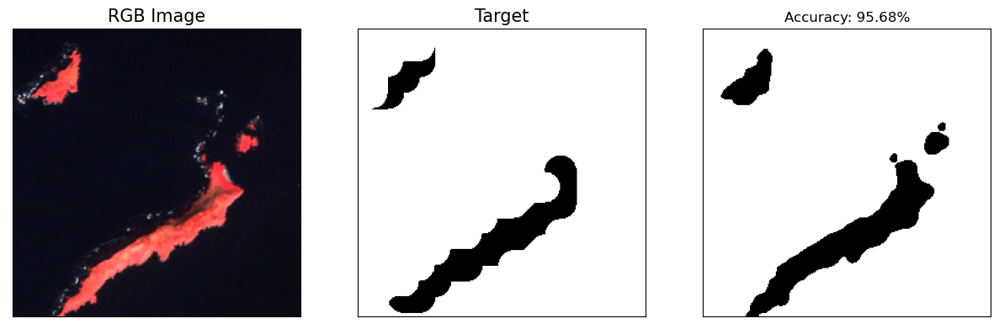

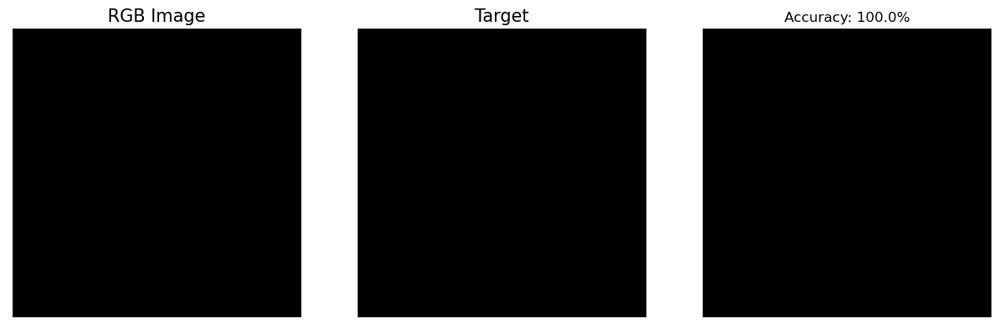

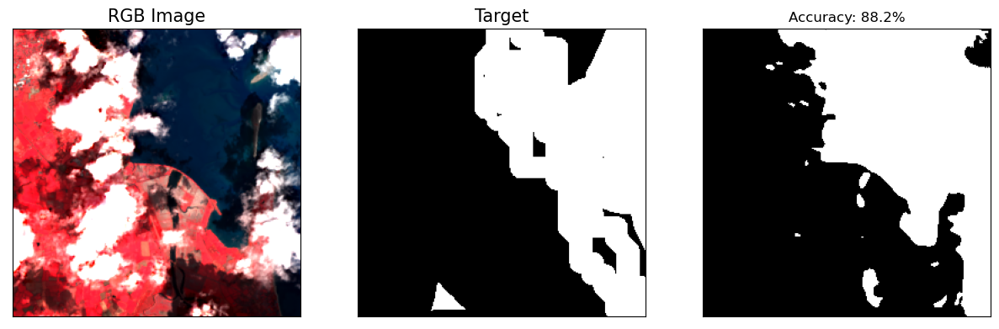

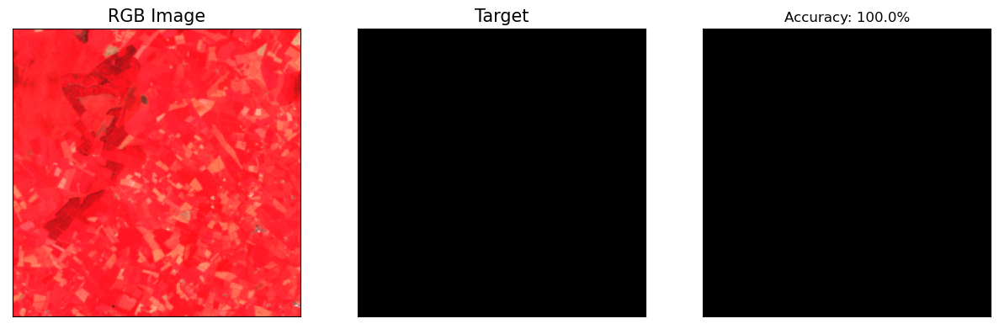

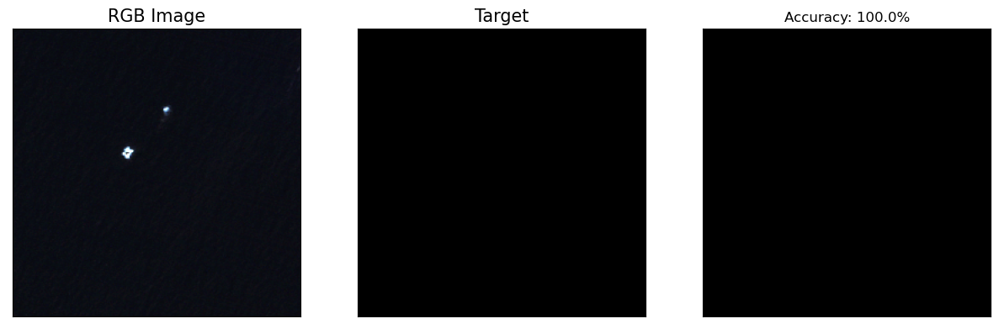

...

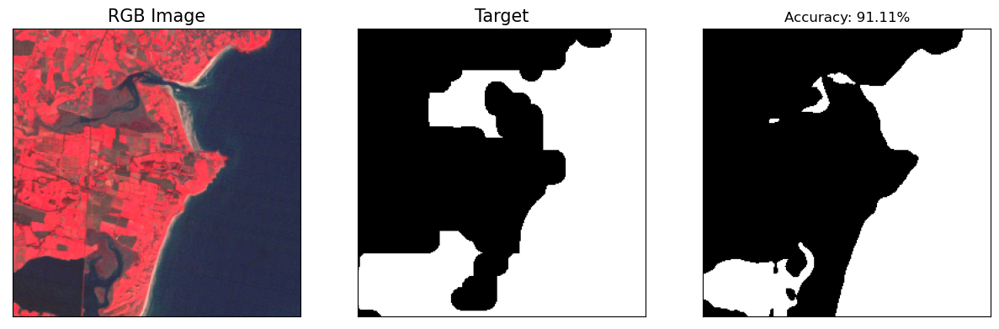

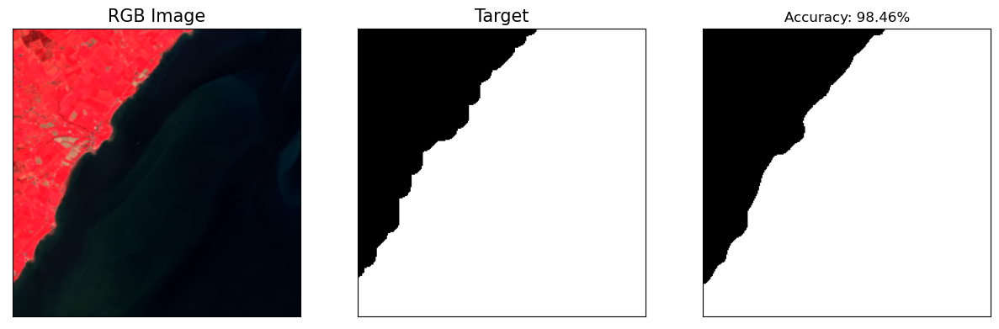

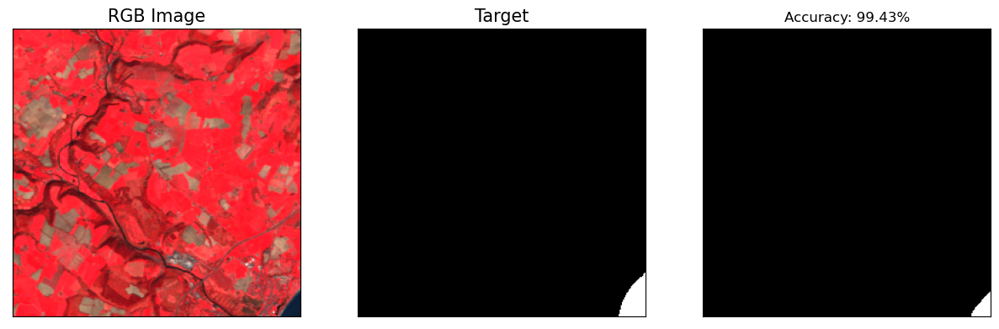

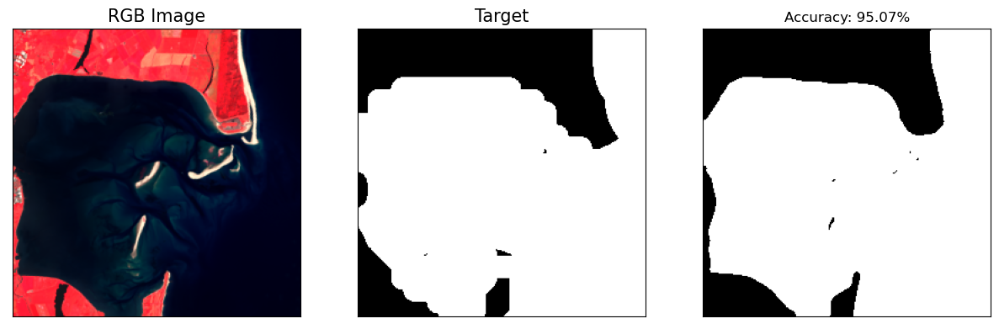

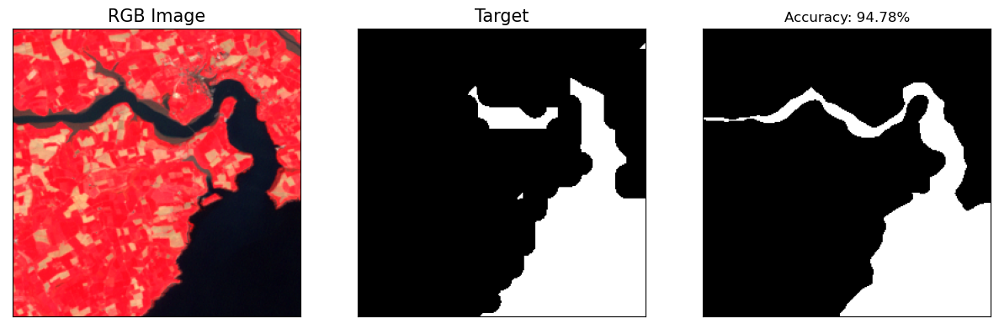

In [19]:
for i in range(100):
    eval.plot_pred(i)

/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_3238/1904126001.py:105: RuntimeWarning: invalid value encountered in long_scalars
  r_balanced_accuracy.append(0.5*(TP_/(TP_+FN_) + TN_/(TN_+FP_)))
/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_3238/1904126001.py:106: RuntimeWarning: invalid value encountered in long_scalars
  r_precision.append(TP_/(TP_+FP_))
/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_3238/1904126001.py:107: RuntimeWarning: invalid value encountered in long_scalars
  r_recall.append(TP_/(TP_+FN_))


Average Metrics
accuracy: 0.9647624206542968
balanced_accuracy: nan
precision: nan
recall: nan
f1: nan
Metrics
accuracy: 0.9647624206542968
balanced_accuracy: 0.9635327235197196
precision: 0.9684484908590548
recall: 0.952072109768642
f1: 0.9601904791784931


(array([ 0.,  5., 10., 15., 20., 25., 30., 35., 40.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

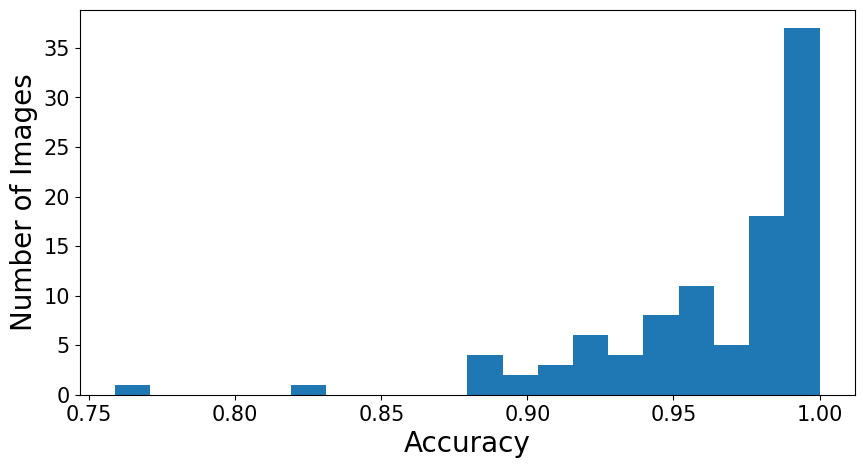

In [12]:
r_metrics, metrics = eval.eval_metrics()
accuracy = r_metrics['accuracy']

print("Average Metrics\n=================")
for m in ['accuracy','balanced_accuracy','precision','recall','f1']:
    print("{}: {}".format(m,np.mean(r_metrics[m])))

print("Metrics\n=================")
for m in ['accuracy','balanced_accuracy','precision','recall','f1']:
    print("{}: {}".format(m,metrics[m]))


# Plot accuracy
plt.figure(figsize=(10,5))

plt.hist(accuracy, bins=20)
plt.xlabel("Accuracy",size=20)
plt.ylabel("Number of Images",size=20)
plt.xticks(size=15)
plt.yticks(size=15)

In [31]:
band_dict = {'Blue':0,'Green':1,'Red':2,'NIR':3,'SWIR 1':4,'SWIR 2':5,'thermal':6}

oringal_bands = ['Blue','Green','Red','NIR','SWIR 1','SWIR 2','thermal']

perm_bands = []
for band in oringal_bands:
    perm_bands.append([band])

# Calculate permutation importance
n = 5
rows = []

accuracy = eval.get_perm_accuracy([])
rows.append([str([]),0,accuracy])

for bands in perm_bands:
    print(bands,end=" ")
    for i in range(n):
        accuracy = eval.get_perm_accuracy(bands)
        row = [str(bands),i,accuracy] 
        rows.append(row)

        print(i,end=" ")

    print()
    
df_metrics = pd.DataFrame(rows,columns = ['Bands',"Perm","Accuracy"])
df_metrics.to_csv(base_path+ 'perm_metrics_17JUN23.csv',index=False)
df_metrics.head()

['Blue'] 0 1 2 3 4 
['Green'] 0 1 2 3 4 
['Red'] 0 1 2 3 4 
['NIR'] 0 1 2 3 4 
['SWIR 1'] 0 1 2 3 4 
['SWIR 2'] 0 1 2 3 4 
['thermal'] 0 1 2 3 4 


,Bands,Perm,Accuracy
0,[],0,0.964762
1,['Blue'],0,0.965356
2,['Blue'],1,0.965328
3,['Blue'],2,0.965345
4,['Blue'],3,0.965312


Blue -0.06
Green 0.07
Red -0.1
NIR 24.37
SWIR 1 1.39
SWIR 2 -0.11
thermal 0.03


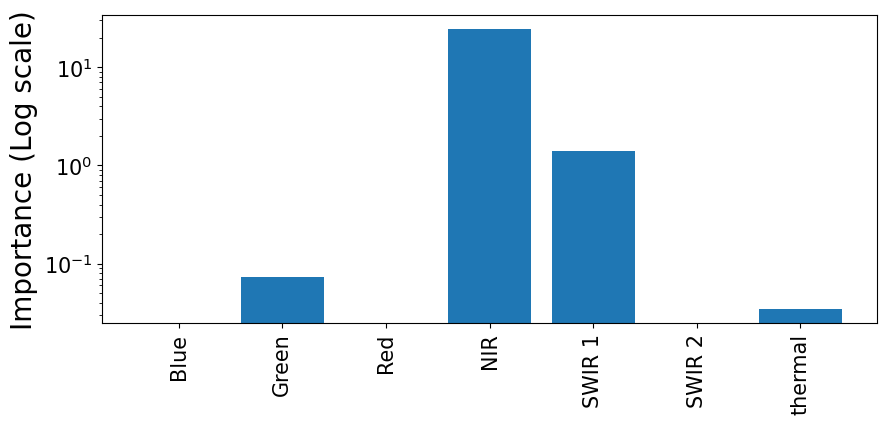

In [33]:
# Plot permutation importance for individual bands
df_metrics = pd.read_csv(base_path+ 'perm_metrics_17JUN23.csv')
mean = df_metrics[['Bands','Accuracy']].groupby(["Bands"], sort=False ).mean().reset_index()

orginal_accuracy = mean['Accuracy'].values[0]
bands = mean['Accuracy'].values[1:8]
importance = [(orginal_accuracy-b)*100 for b in bands]

for i,imp in enumerate(importance):
    print(oringal_bands[i],np.round(imp,2))

eval.plot_importance(importance,oringal_bands,label="Importance (Log scale)")